In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from xgboost.sklearn import XGBRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import BayesianRidge
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.linear_model import Lasso
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder 

# Data preparation

In [2]:
DF=pd.read_csv('loans.csv')
DF.head(2)

,LoanNr_ChkDgt,Name,Sector,City,State,Zip,Bank,BankState,NAICS,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,DisbursementGross,GrAppv,SBA_Appv,default_amount
0,8665963006,CERTIFIED TRANSMISSION & DRIVE,Other services (except public administration),LINDON,UT,84042,ZIONS FIRST NATIONAL BANK,UT,811113,1995,4,1.0,0,0,1,0,274000.0,274000.0,191800.0,0.0
1,2123995005,"ALA ENTERPRISES, INC. DBA NICK",Accommodation and food services,VALENCIA,CA,91381,CAPITAL ONE NATL ASSOC,VA,722110,2007,15,2.0,0,15,0,1,50000.0,50000.0,25000.0,45803.0


In [3]:
DF['Charged_off']=np.where(DF['default_amount']==0,0,1)
DF.head(2)

,LoanNr_ChkDgt,Name,Sector,City,State,Zip,Bank,BankState,NAICS,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,DisbursementGross,GrAppv,SBA_Appv,default_amount,Charged_off
0,8665963006,CERTIFIED TRANSMISSION & DRIVE,Other services (except public administration),LINDON,UT,84042,ZIONS FIRST NATIONAL BANK,UT,811113,1995,4,1.0,0,0,1,0,274000.0,274000.0,191800.0,0.0,0
1,2123995005,"ALA ENTERPRISES, INC. DBA NICK",Accommodation and food services,VALENCIA,CA,91381,CAPITAL ONE NATL ASSOC,VA,722110,2007,15,2.0,0,15,0,1,50000.0,50000.0,25000.0,45803.0,1


In [4]:
DF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83656 entries, 0 to 83655
Data columns (total 21 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   LoanNr_ChkDgt      83656 non-null  int64  
 1   Name               83656 non-null  object 
 2   Sector             83656 non-null  object 
 3   City               83656 non-null  object 
 4   State              83656 non-null  object 
 5   Zip                83656 non-null  int64  
 6   Bank               83656 non-null  object 
 7   BankState          83656 non-null  object 
 8   NAICS              83656 non-null  int64  
 9   ApprovalFY         83656 non-null  int64  
 10  NoEmp              83656 non-null  int64  
 11  NewExist           83640 non-null  float64
 12  CreateJob          83656 non-null  int64  
 13  RetainedJob        83656 non-null  int64  
 14  FranchiseCode      83656 non-null  int64  
 15  UrbanRural         83656 non-null  int64  
 16  DisbursementGross  836

In [5]:
DF.describe()

,LoanNr_ChkDgt,Zip,NAICS,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,DisbursementGross,GrAppv,SBA_Appv,default_amount,Charged_off
count,8.365600e+04,83656.000000,83656.000000,83656.000000,83656.000000,83640.000000,83656.000000,83656.000000,83656.000000,83656.000000,8.365600e+04,8.365600e+04,8.365600e+04,8.365600e+04,83656.000000
mean,4.576267e+09,53145.366417,516179.465896,2002.991871,9.345450,1.261538,2.021588,5.152099,2339.442252,0.928816,1.826560e+05,1.708536e+05,1.293133e+05,1.443084e+04,0.229499
std,2.518241e+09,32281.099480,171585.227190,4.457078,69.002108,0.441104,9.541254,18.911062,11816.210064,0.557592,2.741505e+05,2.721354e+05,2.201240e+05,6.354012e+04,0.420513
min,1.000104e+09,0.000000,111110.000000,1990.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000e+03,1.000000e+03,5.000000e+02,0.000000e+00,0.000000
25%,2.361130e+09,21234.000000,423910.000000,2001.000000,2.000000,1.000000,0.000000,0.000000,0.000000,1.000000,3.500000e+04,2.500000e+04,1.450000e+04,0.000000e+00,0.000000
50%,4.111615e+09,54901.000000,516110.000000,2004.000000,4.000000,1.000000,0.000000,2.000000,1.000000,1.000000,8.000000e+04,6.000000e+04,4.000000e+04,0.000000e+00,0.000000
75%,6.667517e+09,84663.000000,621340.000000,2006.000000,8.000000,2.000000,2.000000,5.000000,1.000000,1.000000,2.000000e+05,1.834250e+05,1.350000e+05,0.000000e+00,0.000000
max,9.995473e+09,99999.000000,928120.000000,2010.000000,8041.000000,2.000000,1016.000000,3860.000000,92006.000000,2.000000,5.294366e+06,4.000000e+06,4.000000e+06,1.895579e+06,1.000000


In [6]:
DF.isna().sum()

LoanNr_ChkDgt         0
Name                  0
Sector                0
City                  0
State                 0
Zip                   0
Bank                  0
BankState             0
NAICS                 0
ApprovalFY            0
NoEmp                 0
NewExist             16
CreateJob             0
RetainedJob           0
FranchiseCode         0
UrbanRural            0
DisbursementGross     0
GrAppv                0
SBA_Appv              0
default_amount        0
Charged_off           0
dtype: int64

In [7]:
DF.groupby(['NewExist'])['NewExist'].count()

NewExist
0.0       60
1.0    61645
2.0    21935
Name: NewExist, dtype: int64

- As you described the data, NewExist Column has only two values 1=Existing business and 2=New business.
- So i suppose 0 is wrong value and i will immpute it by most frequent value.

In [8]:
DF['NewExist'].replace({0:np.nan}, inplace=True)
DF.isna().sum()

LoanNr_ChkDgt         0
Name                  0
Sector                0
City                  0
State                 0
Zip                   0
Bank                  0
BankState             0
NAICS                 0
ApprovalFY            0
NoEmp                 0
NewExist             76
CreateJob             0
RetainedJob           0
FranchiseCode         0
UrbanRural            0
DisbursementGross     0
GrAppv                0
SBA_Appv              0
default_amount        0
Charged_off           0
dtype: int64

In [9]:
DF['NewExist'].fillna(DF['NewExist'].mode()[0],inplace=True)
DF['NewExist'].isna().sum()

0

# Exploratory Data analysis

In [10]:
#!pip install plotly --upgrade

In [11]:
#import plotly.plotly as py
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode(connected=True)

# Sectors Visualization 

In [12]:
groupped_sector=DF.groupby(['Sector']).agg({'CreateJob':'sum','Sector':'count',
                                            'RetainedJob':'sum','NoEmp':'sum',
                                            'default_amount':'mean','Charged_off':'sum'})

groupped_sector.rename({'Sector':'Sector counts','Charged_off':'Charged off sum',
                         'CreateJob':'number of jobs created by sectors',
                        'RetainedJob':'number of jobs Retained by sectors',
                        'NoEmp':'NoEmp by sectors','default_amount':'average_default_amount'},axis=1,inplace=True)
groupped_sector=groupped_sector.reset_index()
groupped_sector

,Sector,number of jobs created by sectors,Sector counts,number of jobs Retained by sectors,NoEmp by sectors,average_default_amount,Charged off sum
0,Accommodation and food services,35549,7743,62638,92982,23879.790004,1878
1,Administrative and support and waste managemen...,9482,4007,28744,58074,11930.556277,1103
2,"Agriculture, forestry, fishing and hunting",451,874,1646,5619,16323.751716,86
3,"Arts, entertainment, and recreation",3979,1680,11880,14917,17206.144643,389
4,Construction,12473,8034,44842,81193,13414.143391,2142
5,Educational services,2023,844,5516,7063,11259.687204,232
6,Finance and insurance,2286,1232,5325,6667,10626.374188,395
7,Health care and social assistance,13860,6628,31621,63591,9540.299487,759
8,Information,2871,1427,6897,10883,11148.257884,396
9,Management of companies and enterprises,131,30,82,322,7424.200000,3


In [13]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots


# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=3,cols=2,specs=[[{'type':'domain'},{'type':'domain'}],
                                         [{'type':'domain'},{'type':'domain'}],
                                         [{'type':'domain'},{'type':'domain'}]])

fig.add_trace(go.Pie(labels=groupped_sector['Sector'],
                     values=groupped_sector['number of jobs created by sectors'], 
                     name="percent of jobs created per sector"),
                     row=1,col= 1)


fig.add_trace(go.Pie(labels=groupped_sector['Sector'],
                     values=groupped_sector['number of jobs Retained by sectors'],
                     name="Percent retained per sector"),
                     row=1,col=2)


fig.add_trace(go.Pie(labels=groupped_sector['Sector'],
                     values=groupped_sector['Sector counts'],
                     name="Percent of all sectors"),
                     row=2,col=1)

fig.add_trace(go.Pie(
           labels=groupped_sector['Sector'], values=groupped_sector['NoEmp by sectors'],
                     name="Percent Emp per sector"),
              row=2,col=2)

fig.add_trace(go.Pie(
           labels=groupped_sector['Sector'], values=groupped_sector['Charged off sum'],
                     name="percent of charged off"),
              row=3,col=1)


# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name")
fig.update_layout(
    title_text="Sectors visulization since 1990 to 2010",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='percent of jobs created per sector',x=0, y=1.05,font_size=12,showarrow=False),
                 dict(text='Percent retained per sector',x=.8, y=1.05,font_size=12,showarrow=False),
                 dict(text='Percent of sectors taking loan',x=0, y=.7,font_size=12, showarrow=False),
                dict(text='percent of Emp per sector',x=.8,y=.7,font_size=12,showarrow=False),
               dict(text='percent of charged off per sector',x=0,y=.3,font_size=12,showarrow=False)],
    autosize=False,width=1300,height=900)

fig.show()

- The retail trade sector has the highest percent 18.42% of taking loans since 1990 to 2010
- The Management of companies and enterprises sector has the lowest percent .035% of taking loans since 1990 to 2010
- The Accommodation and food services sector has the heighest perecent 21.02 of creating new jobs since 1990 to 2010 
- Public administration has the lowest perecent 0.0166 % of creating new jobs since 1990 to 2010
- The Accommodation and food services sector has the heighest perecent 14.53 of retained jobs since 1990 to 2010
- The Management of companies has the lowest perecent 0.019 % of retained jobs since 1990 to 2010
- The Manufacturing sector has the heighest perecent 16.3% of employee since 1990 to 2010
- Public administration has the lowest perecent 0.0219 % of employee since 1990 to 2010
- the retail trade sector has the heighest percent 20.1 of charged off since 1990 to 2010
- The The Management of companies sector has lowest percent 0.0156 oo charged off since 1990 to 2010

In [14]:

fig = go.Figure([go.Bar(x=groupped_sector['Sector'],
                        y=groupped_sector['average_default_amount'],
                        )])

fig.update_layout(title_text="Average charged-off by sectors",
                  autosize=False,width=1000,height=800,
                   yaxis_title ='average amount of charged off',
                  xaxis_title='Sectors',
                  xaxis={'categoryorder':'total descending'})
fig.show()

- On average The Accommodation and food services sector has the highest default amount 1990 to 2010

In [15]:
date_sector=DF.groupby(['Sector','ApprovalFY']).agg({'default_amount':'mean',
                                                    'Charged_off':'sum',
                                                     'default_amount':'sum'})

date_sector.rename({'default_amount':'average_default_amount',
                    'Charged_off':'Charged_off_sum',},axis=1,inplace=True)
date_sector=date_sector.reset_index()
date_sector

,Sector,ApprovalFY,average_default_amount,Charged_off_sum
0,Accommodation and food services,1990,0.0,0
1,Accommodation and food services,1991,0.0,0
2,Accommodation and food services,1992,182154.0,1
3,Accommodation and food services,1993,0.0,0
4,Accommodation and food services,1994,56.0,1
...,...,...,...,...
397,Wholesale trade,2006,16811739.0,279
398,Wholesale trade,2007,15059475.0,290
399,Wholesale trade,2008,8014008.0,127
400,Wholesale trade,2009,2012647.0,27


In [16]:
fig4= px.bar(date_sector, x = 'ApprovalFY', y = 'Charged_off_sum', 
      color = 'Sector', barmode = 'stack', 
      )
fig4.update_layout(title = "Charged-off count by sectors throw years",
      template ='plotly_white',xaxis_title = 'Years', 
      yaxis_title ='Charged off ', width = 1300, height =500,xaxis={'categoryorder':'total descending'})
fig4.show()

- 2007 has the highest charged off number and 
- Retail trade has the most number of charged off at 2007


In [17]:
fig=go.Figure([go.Pie(
           labels=date_sector['ApprovalFY'], values=date_sector['Charged_off_sum'],
                     name="percent of charged off")])
fig.show()

- Change rate percent of charged-off highly increasing after 2001, So I guess it's because 11th of September

- Adding dummy variabile for 11th of septemper and I will see if effect on mode performance or no 

In [18]:
DF['11 of Septemper'] = np.where(DF['ApprovalFY']==(2002 or 2003 or 2004 or 2005 or 2006 or 2007), 1, 0)
DF.head()

,LoanNr_ChkDgt,Name,Sector,City,State,Zip,Bank,BankState,NAICS,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,DisbursementGross,GrAppv,SBA_Appv,default_amount,Charged_off,11 of Septemper
0,8665963006,CERTIFIED TRANSMISSION & DRIVE,Other services (except public administration),LINDON,UT,84042,ZIONS FIRST NATIONAL BANK,UT,811113,1995,4,1.0,0,0,1,0,274000.0,274000.0,191800.0,0.0,0,0
1,2123995005,"ALA ENTERPRISES, INC. DBA NICK",Accommodation and food services,VALENCIA,CA,91381,CAPITAL ONE NATL ASSOC,VA,722110,2007,15,2.0,0,15,0,1,50000.0,50000.0,25000.0,45803.0,1,0
2,8952424007,MARGISON GRAPHICS,"Professional, scientific, and technical services",NEW CASTLE,IN,47362,STAR FINANCIAL BANK,IN,541430,2005,4,1.0,0,0,1,1,105295.0,110000.0,93500.0,0.0,0,0
3,2322574004,GOLF AMERICA OF EAGAN INC,Retail trade,EAGAN,MN,55122,WELLS FARGO BANK NATL ASSOC,SD,451110,1998,26,1.0,6,0,1,0,80000.0,80000.0,64000.0,0.0,0,0
4,5164994009,SOFIA AUTOMOTIVE CENTER INC,Other services (except public administration),ROCHESTER,NY,14609,BANK OF AMERICA NATL ASSOC,NC,811121,2002,20,1.0,0,20,1,1,50000.0,50000.0,25000.0,0.0,0,1


In [19]:
fig4= px.bar(date_sector, x = 'ApprovalFY', y = 'average_default_amount', 
      color = 'Sector', barmode = 'stack', 
      )
fig4.update_layout(title = "Average charged-off by sectors throw years",
      template ='plotly_white',xaxis_title = 'Years', 
      yaxis_title ='Charged off average', width = 1200, height =500,xaxis={'categoryorder':'total descending'})
fig4.show()

- On average 1999 and 2007 have the highest Charged off average 
- Public administration is the highest at 1999 and Accommodation and food services is the highest at 2007

# States Visualization

In [20]:
DF.head(5)

,LoanNr_ChkDgt,Name,Sector,City,State,Zip,Bank,BankState,NAICS,ApprovalFY,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,DisbursementGross,GrAppv,SBA_Appv,default_amount,Charged_off,11 of Septemper
0,8665963006,CERTIFIED TRANSMISSION & DRIVE,Other services (except public administration),LINDON,UT,84042,ZIONS FIRST NATIONAL BANK,UT,811113,1995,4,1.0,0,0,1,0,274000.0,274000.0,191800.0,0.0,0,0
1,2123995005,"ALA ENTERPRISES, INC. DBA NICK",Accommodation and food services,VALENCIA,CA,91381,CAPITAL ONE NATL ASSOC,VA,722110,2007,15,2.0,0,15,0,1,50000.0,50000.0,25000.0,45803.0,1,0
2,8952424007,MARGISON GRAPHICS,"Professional, scientific, and technical services",NEW CASTLE,IN,47362,STAR FINANCIAL BANK,IN,541430,2005,4,1.0,0,0,1,1,105295.0,110000.0,93500.0,0.0,0,0
3,2322574004,GOLF AMERICA OF EAGAN INC,Retail trade,EAGAN,MN,55122,WELLS FARGO BANK NATL ASSOC,SD,451110,1998,26,1.0,6,0,1,0,80000.0,80000.0,64000.0,0.0,0,0
4,5164994009,SOFIA AUTOMOTIVE CENTER INC,Other services (except public administration),ROCHESTER,NY,14609,BANK OF AMERICA NATL ASSOC,NC,811121,2002,20,1.0,0,20,1,1,50000.0,50000.0,25000.0,0.0,0,1


In [21]:
date_State=DF.groupby(['State','Sector']).agg({'Charged_off':'sum','NoEmp':'sum'})

date_State.rename({'Charged_off':'Charged_off_sum','NoEmp':'no of employee'},axis=1,inplace=True)
date_State=date_State.reset_index()
date_State

,State,Sector,Charged_off_sum,no of employee
0,AK,Accommodation and food services,4,285
1,AK,Administrative and support and waste managemen...,0,9
2,AK,"Agriculture, forestry, fishing and hunting",2,131
3,AK,"Arts, entertainment, and recreation",2,64
4,AK,Construction,2,153
...,...,...,...,...
897,WY,Real estate and rental and leasing,1,2
898,WY,Retail trade,4,238
899,WY,Transportation and warehousing,0,3
900,WY,Utilities,0,5


In [22]:
fig4= px.bar(date_State, x = 'State', y = 'Charged_off_sum', 
      color = 'Sector', barmode = 'stack', 
      )
fig4.update_layout(title = "Charged-off per states",
      template ='plotly_white',xaxis_title = 'States', 
      yaxis_title ='Charged-off', width = 1300, height =500,xaxis={'categoryorder':'total descending'})
fig4.show()

- California has the most charged off 
- Retai trade is the most charged of  in California

In [23]:
fig4= px.bar(date_State, x = 'State', y = 'no of employee', 
      color = 'Sector', barmode = 'stack', 
      )
fig4.update_layout(title = "Number of employee per States",
      template ='plotly_white',xaxis_title = 'States', 
      yaxis_title ='No of employee', width = 1300, height =500,xaxis={'categoryorder':'total descending'})
fig4.show()

- California has the most Number of employee
- Manufacturing has the most of employee in California

In [24]:
df=pd.merge(DF,date_sector,how='inner',left_on=['Sector'],right_on=['Sector'])
df.drop('Sector',axis=1,inplace=True)
df.shape
df.head(3)

,LoanNr_ChkDgt,Name,City,State,Zip,Bank,BankState,NAICS,ApprovalFY_x,NoEmp,NewExist,CreateJob,RetainedJob,FranchiseCode,UrbanRural,DisbursementGross,GrAppv,SBA_Appv,default_amount,Charged_off,11 of Septemper,ApprovalFY_y,average_default_amount,Charged_off_sum
0,8665963006,CERTIFIED TRANSMISSION & DRIVE,LINDON,UT,84042,ZIONS FIRST NATIONAL BANK,UT,811113,1995,4,1.0,0,0,1,0,274000.0,274000.0,191800.0,0.0,0,0,1990,1283021.0,7
1,8665963006,CERTIFIED TRANSMISSION & DRIVE,LINDON,UT,84042,ZIONS FIRST NATIONAL BANK,UT,811113,1995,4,1.0,0,0,1,0,274000.0,274000.0,191800.0,0.0,0,0,1991,476614.0,3
2,8665963006,CERTIFIED TRANSMISSION & DRIVE,LINDON,UT,84042,ZIONS FIRST NATIONAL BANK,UT,811113,1995,4,1.0,0,0,1,0,274000.0,274000.0,191800.0,0.0,0,0,1992,600193.0,6


# Numeric features Visualization

- DisbursementGross, NoEmp, GrAppv and SBA_Appv are heavily skewed to zero so I transformed it using log1p to make them normally distributed.
- I hope these trasnformation will enhance model performance

In [25]:
DF['logDisbursementGross']=np.log1p(DF['DisbursementGross'])
DF['logNoEmp']=np.log1p(DF['NoEmp'])
DF['logGrAppv']=np.log1p(DF['GrAppv'])
DF['logSBA_Appv']=np.log1p(DF['SBA_Appv'])

In [26]:
fig = px.histogram(DF, x="DisbursementGross")
fig.show()

In [27]:
fig = px.histogram(DF, x="logDisbursementGross")
fig.show()

In [28]:

fig = px.scatter(DF, x="SBA_Appv", y="default_amount", trendline="ols",hover_data=['default_amount'])
fig.show()

In [29]:
DF['logEmp'] = np.log1p(DF['NoEmp'])
fig = px.scatter(DF, x="logEmp", y="default_amount", trendline="ols",hover_data=['default_amount'])
fig.show()

In [30]:
correlation_matrix =DF.corr().round(2)
#annot = True to print the values inside the square
sns.set(rc={'figure.figsize':(200,150)})
sns.set(font_scale=12)
sns.heatmap(data=correlation_matrix,annot=True,annot_kws={"size":120})

<AxesSubplot:>

# Data Preprocessing

In [31]:
df_cat=DF[['Sector','City','State','BankState','ApprovalFY','NewExist',
           'FranchiseCode','UrbanRural','Charged_off','11 of Septemper']]

df_dummies=pd.get_dummies(df_cat)
df_dummies.head()

,ApprovalFY,NewExist,FranchiseCode,UrbanRural,Charged_off,11 of Septemper,Sector_Accommodation and food services,Sector_Administrative and support and waste management and remediation services,"Sector_Agriculture, forestry, fishing and hunting","Sector_Arts, entertainment, and recreation",Sector_Construction,Sector_Educational services,Sector_Finance and insurance,Sector_Health care and social assistance,Sector_Information,Sector_Management of companies and enterprises,Sector_Manufacturing,"Sector_Mining, quarrying, and oil and gas extraction",Sector_Other services (except public administration),"Sector_Professional, scientific, and technical services",Sector_Public administration,Sector_Real estate and rental and leasing,Sector_Retail trade,Sector_Transportation and warehousing,Sector_Utilities,Sector_Wholesale trade,City_105 N MILES,City_116 EAST THIRD STREET,City_1332 SOUTH HIGHWAY 14,City_1425 SW 1ST AVENUE,City_217 EAST HANOVER STREET,"City_2209 IRVING ST., SAN FRAN",City_516 EAST FIREWEED LANE,City_A056740936,City_ABBEVILLE,City_ABBOTSFORD,City_ABBOTT,City_ABERDEEN,City_ABERDEEN TOWNSHIP,City_ABILENE,City_ABINGDON,City_ABINGTON,City_ABINGTON ( CDP NAME: ABINGTON,City_ABRAHAM,City_ABRAMS,City_ABSAROKEE,City_ABSECON,City_ACCOKEEK,City_ACCORD,City_ACCOTINK,City_ACCOTINK HEIGHTS,City_ACME,City_ACRE HOMES,City_ACREDALE,City_ACTON,City_ACUSHNET,City_ACWORTH,City_ADA,City_ADAIRSVILLE,City_ADAMS,City_ADAMS CITY,City_ADAMSTOWN,City_ADDISON,City_ADEL,City_ADELANTO,City_ADELL,City_ADELPHI,City_ADRIAN,City_ADVANCE,City_ADVENTURA,City_AFFTON,City_AFTON,City_AGAWAM,City_AGOURA,City_AGOURA HILLS,City_AGRA,City_AGUA DOLCE,City_AHOSKIE,City_AHWAHNEE,City_AIEA,City_AIKEN,City_AINSWORTH,City_AIRPORT,City_AIRPORT MAIL FACILITY,City_AIRWAY HEIGHTS,City_AKCHIN (AK CHIN),City_AKRON,City_AKRON SUMMIT COUNTY,City_AL TAHOE,City_ALABASTER,City_ALACHUA,City_ALAMEDA,City_ALAMO,City_ALAMOGORDO,City_ALAMOSA,City_ALBANY,City_ALBANY OR,City_ALBEMARLE,City_ALBERT LEA,City_ALBERTON,City_ALBERTSON,City_ALBERTVILLE,City_ALBION,City_ALBUQUERQUE,City_ALBURTIS,City_ALCOA,City_ALCOVA,City_ALDAN,City_ALDEN,City_ALEDO,City_ALEWA HEIGHTS,City_ALEXANDER,City_ALEXANDER CITY,City_ALEXANDRIA,City_ALEXNDER CITY,City_ALGIERS,City_ALGODONES,City_ALGONA,City_ALGONAC,City_ALGONQUIN,City_ALHAMBRA,City_ALICE,City_ALIQUIPPA,City_ALISO VIEJO,City_ALLAIRE,City_ALLEGAN,City_ALLEGANY,City_ALLEGHENY,City_ALLEGHENY (NORTHSIDE),City_ALLEN,City_ALLEN PARK,City_ALLENDALE,City_ALLENHURST,City_ALLENPORT,City_ALLENSTOWN,City_ALLENTON,City_ALLENTOWN,City_ALLERTON,City_ALLIANCE,City_ALLISON PARK,City_ALLSTON,City_ALLYN,City_ALMA,City_ALMENA,City_ALMO,City_ALOHA,City_ALPENA,City_ALPHARETTA,City_ALPHATETTA,City_ALPINE,City_ALSEA,City_ALSIO VIEJO,City_ALSIP,City_ALTA LOMA,City_ALTADENA,City_ALTAMONT,City_ALTAMONTA SPRINGS,City_ALTAMONTE SPRING,City_ALTAMONTE SPRINGS,City_ALTMAR,City_ALTO,City_ALTON,City_ALTON BAY,City_ALTOONA,City_ALTUS,City_ALUM BANK (CORPORATE NAME PLEA,City_ALUM ROCK,City_ALVARADO,City_ALVIN,City_ALVO,City_AMANA,City_AMARILLO,City_AMBLER,City_AMBOY,City_AMBRIDGE,City_AMELIA,City_AMELIA COURT HOUSE (RR NAME AM,City_AMERICAN CANYON,City_AMERICAN FALLS,City_AMERICAN FORK,City_AMERICUS,City_AMERY,City_AMES,City_AMESBURY,City_AMESBURY (TOWN OF),City_AMHERST,City_AMHERST (CENSUS NAME FOR AMHER,City_AMITY,City_AMITYVILLE,City_AMMON,City_AMSTERDAM,City_ANABELLA,City_ANACONDA,City_ANACORTES,City_ANAHEIM,City_ANAHEIM HILLS,City_ANAHIEM,City_ANAHOLA,City_ANASTASIA,City_ANCHORAGE,City_ANCHORGE,City_ANDALUSIA,City_ANDERSON,City_ANDOVER,City_ANDREAS,City_ANDREWS,City_ANETH,City_ANGEL FIRE,City_ANGIER,City_ANGLETON,City_ANGOLA,City_ANKENY,City_ANN ARBOR,City_ANNA,City_ANNABELLA,City_ANNADALE,City_ANNANDALE,City_ANNAPOLIS,City_ANNISTON,City_ANOKA,City_ANSON,City_ANSONIA,City_ANSTED,City_ANTELOPE,City_ANTHONY,City_ANTIGO,City_ANTIOCH,City_ANTLERS PARK,City_ANTON,City_ANTRIM,City_APACHE JUNCTION,City_APALACHIN,City_APEX,City_APOLLO,City_APOLLO BEACH,City_APOPKA,City_APPLE CREEK,City_APPLE V

In [32]:
df_lb=df_cat.apply(LabelEncoder().fit_transform)
df_lb

,Sector,City,State,BankState,ApprovalFY,NewExist,FranchiseCode,UrbanRural,Charged_off,11 of Septemper
0,12,5403,44,44,5,0,1,0,0,0
1,0,10313,4,45,17,1,0,1,1,0
2,13,6806,15,15,15,0,1,1,0,0
3,16,2696,23,41,8,0,1,0,0,0
4,12,8444,34,27,12,0,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...
83651,16,1858,34,4,17,1,640,1,1,0
83652,16,2787,39,45,16,0,0,1,0,0
83653,1,9495,10,27,17,1,0,1,0,0
83654,5,4081,4,45,16,0,0,1,0,0


In [33]:
df_num=DF[['CreateJob','RetainedJob','DisbursementGross','GrAppv',
           'SBA_Appv','logDisbursementGross','logNoEmp','logGrAppv','logSBA_Appv']]
df_num

,CreateJob,RetainedJob,DisbursementGross,GrAppv,SBA_Appv,logDisbursementGross,logNoEmp,logGrAppv,logSBA_Appv
0,0,0,274000.0,274000.0,191800.0,12.520887,1.609438,12.520887,12.164214
1,0,15,50000.0,50000.0,25000.0,10.819798,2.772589,10.819798,10.126671
2,0,0,105295.0,110000.0,93500.0,11.564531,1.609438,11.608245,11.445727
3,6,0,80000.0,80000.0,64000.0,11.289794,3.295837,11.289794,11.066654
4,0,20,50000.0,50000.0,25000.0,10.819798,3.044522,10.819798,10.126671
...,...,...,...,...,...,...,...,...,...
83651,0,3,207200.0,207200.0,155400.0,12.241445,1.386294,12.241445,11.953764
83652,0,1,15000.0,15000.0,7500.0,9.615872,0.693147,9.615872,8.922792
83653,0,1,7400.0,5000.0,2500.0,8.909370,0.693147,8.517393,7.824446
83654,2,8,50000.0,50000.0,25000.0,10.819798,2.197225,10.819798,10.126671


In [34]:
features = df_num.columns.values
# define standard scaler
scaler = MinMaxScaler()
# transform data
scaled = pd.DataFrame(scaler.fit_transform(df_num))
scaled.columns=features
scaled.head()

,CreateJob,RetainedJob,DisbursementGross,GrAppv,SBA_Appv,logDisbursementGross,logNoEmp,logGrAppv,logSBA_Appv
0,0.000000,0.000000,0.051036,0.068267,0.047831,0.588018,0.178977,0.676727,0.661934
1,0.000000,0.003886,0.008695,0.012253,0.006126,0.351356,0.308325,0.471605,0.435167
2,0.000000,0.000000,0.019147,0.027257,0.023253,0.454966,0.178977,0.566678,0.581971
3,0.005906,0.000000,0.014366,0.019755,0.015877,0.416744,0.366512,0.528278,0.539782
4,0.000000,0.005181,0.008695,0.012253,0.006126,0.351356,0.338565,0.471605,0.435167


In [35]:
df_lb=pd.concat([scaled,df_lb],axis=1)
df_lb

,CreateJob,RetainedJob,DisbursementGross,GrAppv,SBA_Appv,logDisbursementGross,logNoEmp,logGrAppv,logSBA_Appv,Sector,City,State,BankState,ApprovalFY,NewExist,FranchiseCode,UrbanRural,Charged_off,11 of Septemper
0,0.000000,0.000000,0.051036,0.068267,0.047831,0.588018,0.178977,0.676727,0.661934,12,5403,44,44,5,0,1,0,0,0
1,0.000000,0.003886,0.008695,0.012253,0.006126,0.351356,0.308325,0.471605,0.435167,0,10313,4,45,17,1,0,1,1,0
2,0.000000,0.000000,0.019147,0.027257,0.023253,0.454966,0.178977,0.566678,0.581971,13,6806,15,15,15,0,1,1,0,0
3,0.005906,0.000000,0.014366,0.019755,0.015877,0.416744,0.366512,0.528278,0.539782,16,2696,23,41,8,0,1,0,0,0
4,0.000000,0.005181,0.008695,0.012253,0.006126,0.351356,0.338565,0.471605,0.435167,12,8444,34,27,12,0,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83651,0.000000,0.000777,0.038409,0.051563,0.038730,0.549141,0.154162,0.643031,0.638512,16,1858,34,4,17,1,640,1,1,0
83652,0.000000,0.000259,0.002079,0.003501,0.001750,0.183862,0.077081,0.326432,0.301183,16,2787,39,45,16,0,0,1,0,0
83653,0.000000,0.000259,0.000643,0.001000,0.000500,0.085571,0.077081,0.193974,0.178943,1,9495,10,27,17,1,0,1,0,0
83654,0.001969,0.002073,0.008695,0.012253,0.006126,0.351356,0.244341,0.471605,0.435167,5,4081,4,45,16,0,0,1,0,0


In [36]:
df_OH=pd.concat([scaled,df_dummies],axis=1)
df_OH

,CreateJob,RetainedJob,DisbursementGross,GrAppv,SBA_Appv,logDisbursementGross,logNoEmp,logGrAppv,logSBA_Appv,ApprovalFY,NewExist,FranchiseCode,UrbanRural,Charged_off,11 of Septemper,Sector_Accommodation and food services,Sector_Administrative and support and waste management and remediation services,"Sector_Agriculture, forestry, fishing and hunting","Sector_Arts, entertainment, and recreation",Sector_Construction,Sector_Educational services,Sector_Finance and insurance,Sector_Health care and social assistance,Sector_Information,Sector_Management of companies and enterprises,Sector_Manufacturing,"Sector_Mining, quarrying, and oil and gas extraction",Sector_Other services (except public administration),"Sector_Professional, scientific, and technical services",Sector_Public administration,Sector_Real estate and rental and leasing,Sector_Retail trade,Sector_Transportation and warehousing,Sector_Utilities,Sector_Wholesale trade,City_105 N MILES,City_116 EAST THIRD STREET,City_1332 SOUTH HIGHWAY 14,City_1425 SW 1ST AVENUE,City_217 EAST HANOVER STREET,"City_2209 IRVING ST., SAN FRAN",City_516 EAST FIREWEED LANE,City_A056740936,City_ABBEVILLE,City_ABBOTSFORD,City_ABBOTT,City_ABERDEEN,City_ABERDEEN TOWNSHIP,City_ABILENE,City_ABINGDON,City_ABINGTON,City_ABINGTON ( CDP NAME: ABINGTON,City_ABRAHAM,City_ABRAMS,City_ABSAROKEE,City_ABSECON,City_ACCOKEEK,City_ACCORD,City_ACCOTINK,City_ACCOTINK HEIGHTS,City_ACME,City_ACRE HOMES,City_ACREDALE,City_ACTON,City_ACUSHNET,City_ACWORTH,City_ADA,City_ADAIRSVILLE,City_ADAMS,City_ADAMS CITY,City_ADAMSTOWN,City_ADDISON,City_ADEL,City_ADELANTO,City_ADELL,City_ADELPHI,City_ADRIAN,City_ADVANCE,City_ADVENTURA,City_AFFTON,City_AFTON,City_AGAWAM,City_AGOURA,City_AGOURA HILLS,City_AGRA,City_AGUA DOLCE,City_AHOSKIE,City_AHWAHNEE,City_AIEA,City_AIKEN,City_AINSWORTH,City_AIRPORT,City_AIRPORT MAIL FACILITY,City_AIRWAY HEIGHTS,City_AKCHIN (AK CHIN),City_AKRON,City_AKRON SUMMIT COUNTY,City_AL TAHOE,City_ALABASTER,City_ALACHUA,City_ALAMEDA,City_ALAMO,City_ALAMOGORDO,City_ALAMOSA,City_ALBANY,City_ALBANY OR,City_ALBEMARLE,City_ALBERT LEA,City_ALBERTON,City_ALBERTSON,City_ALBERTVILLE,City_ALBION,City_ALBUQUERQUE,City_ALBURTIS,City_ALCOA,City_ALCOVA,City_ALDAN,City_ALDEN,City_ALEDO,City_ALEWA HEIGHTS,City_ALEXANDER,City_ALEXANDER CITY,City_ALEXANDRIA,City_ALEXNDER CITY,City_ALGIERS,City_ALGODONES,City_ALGONA,City_ALGONAC,City_ALGONQUIN,City_ALHAMBRA,City_ALICE,City_ALIQUIPPA,City_ALISO VIEJO,City_ALLAIRE,City_ALLEGAN,City_ALLEGANY,City_ALLEGHENY,City_ALLEGHENY (NORTHSIDE),City_ALLEN,City_ALLEN PARK,City_ALLENDALE,City_ALLENHURST,City_ALLENPORT,City_ALLENSTOWN,City_ALLENTON,City_ALLENTOWN,City_ALLERTON,City_ALLIANCE,City_ALLISON PARK,City_ALLSTON,City_ALLYN,City_ALMA,City_ALMENA,City_ALMO,City_ALOHA,City_ALPENA,City_ALPHARETTA,City_ALPHATETTA,City_ALPINE,City_ALSEA,City_ALSIO VIEJO,City_ALSIP,City_ALTA LOMA,City_ALTADENA,City_ALTAMONT,City_ALTAMONTA SPRINGS,City_ALTAMONTE SPRING,City_ALTAMONTE SPRINGS,City_ALTMAR,City_ALTO,City_ALTON,City_ALTON BAY,City_ALTOONA,City_ALTUS,City_ALUM BANK (CORPORATE NAME PLEA,City_ALUM ROCK,City_ALVARADO,City_ALVIN,City_ALVO,City_AMANA,City_AMARILLO,City_AMBLER,City_AMBOY,City_AMBRIDGE,City_AMELIA,City_AMELIA COURT HOUSE (RR NAME AM,City_AMERICAN CANYON,City_AMERICAN FALLS,City_AMERICAN FORK,City_AMERICUS,City_AMERY,City_AMES,City_AMESBURY,City_AMESBURY (TOWN OF),City_AMHERST,City_AMHERST (CENSUS NAME FOR AMHER,City_AMITY,City_AMITYVILLE,City_AMMON,City_AMSTERDAM,City_ANABELLA,City_ANACONDA,City_ANACORTES,City_ANAHEIM,City_ANAHEIM HILLS,City_ANAHIEM,City_ANAHOLA,City_ANASTASIA,City_ANCHORAGE,City_ANCHORGE,City_ANDALUSIA,City_ANDERSON,City_ANDOVER,City_ANDREAS,City_ANDREWS,City_ANETH,City_ANGEL FIRE,City_ANGIER,City_ANGLETON,City_ANGOLA,City_ANKENY,City_ANN ARBOR,City_ANNA,City_ANNABELLA,City_ANNADALE,City_ANNANDALE,City_ANNAPOLIS,City_ANNISTON,City_ANOKA,City_ANSON,City_ANSONIA,City_ANSTED,City_ANTELOPE,City_ANTHONY,City_ANTIGO,City_ANTIOCH,City_ANTLERS PARK,City_ANTON,City_ANTRIM,City_APAC

# Data Splitting

In [37]:
y=DF['default_amount']
y

0             0.0
1         45803.0
2             0.0
3             0.0
4             0.0
           ...   
83651    169028.0
83652         0.0
83653         0.0
83654         0.0
83655         0.0
Name: default_amount, Length: 83656, dtype: float64

In [38]:
X_train_OH, X_test_OH, y_train_OH, y_test_OH = train_test_split(df_OH,y,test_size=0.20,random_state=2,shuffle = True)
X_train_lb, X_test_lb, y_train_lb, y_test_lb = train_test_split(df_lb,y,test_size=0.20,random_state=2,shuffle = True)

# Model Selection 

In [50]:
regressors = {
    "XGBRegressor":XGBRegressor(),
    "RandomForestRegressor":RandomForestRegressor(),
    "DecisionTreeRegressor":DecisionTreeRegressor(),
    #"SVR":SVR(),
    "LinearRegression":LinearRegression(),
    'Lasso':Lasso(),
    #'KernelReidge':KernelRidge(),
    "Ridge":Ridge(),
    #"BayesianRidge": BayesianRidge(),
    "ElasticNet": ElasticNet(),
    #'GradientBoostingRegresso': GradientBoostingRegressor()
}

In [51]:
df_models = pd.DataFrame(columns=['model','R2_test','R2_train','nrmse_test','nrmse_train'])

for key in regressors:

    print('*',key)

    regressor = regressors[key]
    #model = regressor.fit(X_train_lb,y_train_lb)
    #y_pred = model.predict(X_test)
    
    folds = KFold(n_splits =5,shuffle = True,random_state=2)
    scores = cross_validate(regressor,X_train_lb,y_train_lb,scoring=('r2','neg_root_mean_squared_error'),
                            return_train_score=True,cv=folds)
                           
    row = {'model': key+'Label_encoder',
           'R2_test':scores['test_r2'].mean(),
           'R2_train':scores['train_r2'].mean(),
           'nrmse_test':scores['test_neg_root_mean_squared_error'].mean(),
           'nrmse_train':scores['train_neg_root_mean_squared_error'].mean()
          
    }
    
    df_models = df_models.append(row,ignore_index=True)
    
    #scores = cross_validate(regressor,X_train_OH,y_train_OH,scoring=('r2','neg_root_mean_squared_error'),
                           # return_train_score=True,cv=folds)
                           
    #row = {'model': key+'One_hot',
           #'R2_test':scores['test_r2'].mean(),
           #'R2_train':scores['train_r2'].mean(),
           #'nrmse_test':scores['test_neg_root_mean_squared_error'].mean(),
           #'nrmse_train':scores['train_neg_root_mean_squared_error'].mean()}


    #df_models = df_models.append(row,ignore_index=True)


* XGBRegressor
* RandomForestRegressor
* DecisionTreeRegressor
* LinearRegression
* Lasso
* Ridge
* ElasticNet


- I tried to multiple models on one hot encoded and label encoded date to chose best preprocessing and best model but the memory  is exceeded so I validated on label encoded and eliminated some algorithms

In [52]:
df_models.head(20).sort_values(by='nrmse_test', ascending=False)

,model,R2_test,R2_train,nrmse_test,nrmse_train
1,RandomForestRegressorLabel_encoder,0.840466,0.978111,-24741.158290,-9220.830717
0,XGBRegressorLabel_encoder,0.806792,0.980222,-27270.486795,-8762.180733
2,DecisionTreeRegressorLabel_encoder,0.711192,1.000000,-33343.476807,-27.718690
4,LassoLabel_encoder,0.262348,0.263640,-53511.088055,-53520.752170
3,LinearRegressionLabel_encoder,0.262345,0.263680,-53511.228013,-53519.297088
5,RidgeLabel_encoder,0.261970,0.263114,-53524.441557,-53539.883325
6,ElasticNetLabel_encoder,0.095032,0.094876,-59275.499646,-59337.713011


- XGboost has max negative mean squre error on test data and train data so I choose XGBoost to build my model 


In [53]:
XGBRegressor().get_params

<bound method XGBModel.get_params of XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
             colsample_bynode=None, colsample_bytree=None, gamma=None,
             gpu_id=None, importance_type='gain', interaction_constraints=None,
             learning_rate=None, max_delta_step=None, max_depth=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             random_state=None, reg_alpha=None, reg_lambda=None,
             scale_pos_weight=None, subsample=None, tree_method=None,
             validate_parameters=None, verbosity=None)>

# Hyperparamter Tuning

In [66]:
param_Random=dict(
    #n_jobs=[16],
    learning_rate=[0.1,0.5],
    #objective=['reg:squarederror'],
    max_depth=[5,15], 
    n_estimators=[100,1000],
    #subsample=[0.2,0.8,1.0],
    #gamma=[0.05,0.5],
    #scale_pos_weight=[0,1],
    #reg_alpha=[0,0.5],
    #reg_lambda=[1,0],
)

model = XGBRegressor(random_state=1,verbosity=1)

random_search = RandomizedSearchCV(model,
                           param_Random,
                           scoring='neg_root_mean_squared_error',
                           cv=5)

random_search.fit(X_train_lb, y_train_lb)

RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, gamma=None,
                                          gpu_id=None, importance_type='gain',
                                          interaction_constraints=None,
                                          learning_rate=None,
                                          max_delta_step=None, max_depth=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n_jobs=None,
                                          num_parallel_tree=None,
                                          random_state=1, reg_alpha=None,
                                          

- I used random search because it's more faster than grid search and Bayesian search
- I Just show you that is the approach I will follow for model optimization using grid or Bayesian search for Hyperparameter Tuning
- Tuning more parameters needs computation power and time so I eliminate some parameters.

In [67]:
print("Tuned XGB Parameter: {}".format(random_search.best_params_))
print("Tuned XGB best score:{}".format(random_search.best_score_))
print('best estimator:{}'.format(random_search.best_estimator_))

Tuned XGB Parameter: {'n_estimators': 100, 'max_depth': 5, 'learning_rate': 0.1}
Tuned XGB best score:-24973.23812745502
best estimator:XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=5,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=1,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=1)


# Building The Model With tuned paramter

In [39]:
XGB=XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=5,
             min_child_weight=1, monotone_constraints='()',
             n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=1,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=1)
XGB.fit(X_train_lb, y_train_lb)
#y_pred =abs(XGB.predict(X_test_lb)).astype(int)
y_pred =XGB.predict(X_test_lb)
np.sqrt(mean_squared_error(y_test_lb,y_pred))

24670.898390300823

In [41]:
test = pd.DataFrame({'Predicted value':y_pred,'Actual value':y_test_lb})
test = test.reset_index()
test = test.drop(['index'],axis=1)

In [42]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=test.index, y=test['Predicted value'],
                    mode='lines',
                    name='Predicted value'))
fig.add_trace(go.Scatter(x=test.index, y=test['Actual value'],
                    mode='lines',
                    name='Actual value'))

fig.update_layout(title = "Actual Vs Predicted",
      template ='plotly_white',xaxis_title ='Index', 
      yaxis_title ='Charged off amount ', width=1000, height =600,xaxis={'categoryorder':'total descending'})
fig.show()

# Feature selection based on best model feature importance

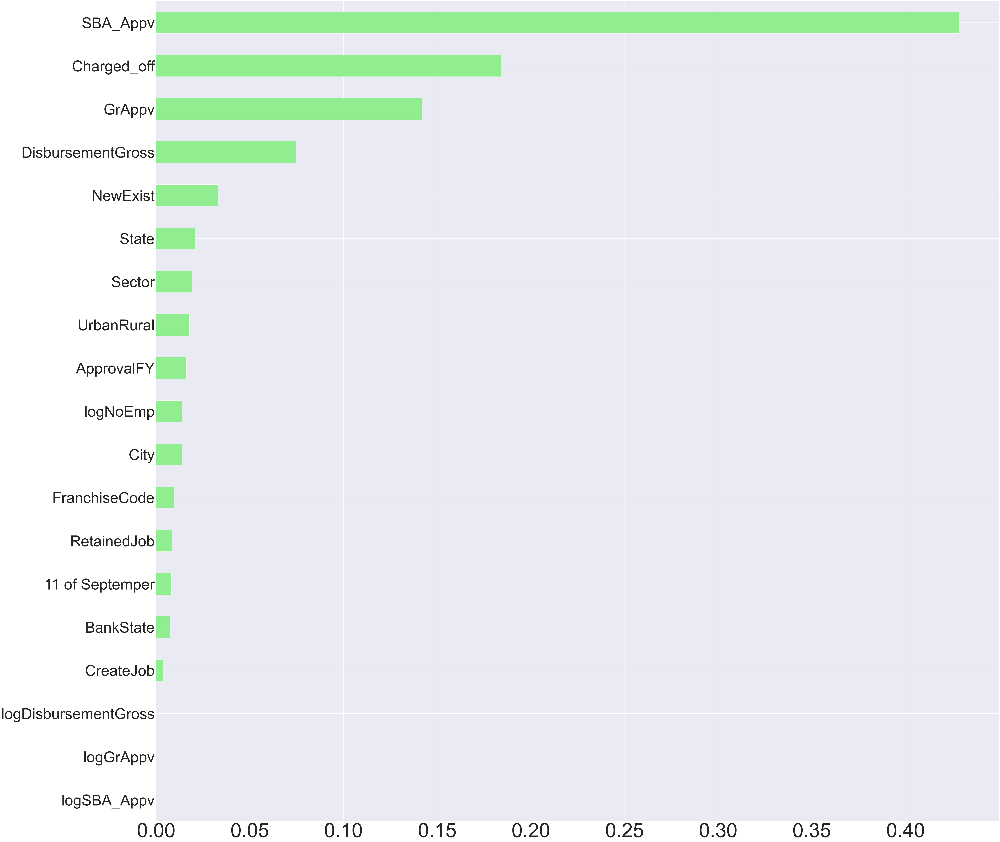

In [105]:
# Create a pd.Series of features importances
importances_Random_Search_XGB= pd.Series(random_search.best_estimator_.feature_importances_, index=X_train_lb.columns)
# Sort importances_dt
sorted_importances_Random_Search_XGB=importances_Random_Search_XGB.sort_values()
# Make a horizontal bar plot

plt.figure(figsize=(100,100))
sorted_importances_Random_Search_XGB.plot(kind='barh', color='lightgreen')   
#plt.xlabel(v,fontsize=300)
#plt.ylabel('Crimes',fontsize=300)
#plt.title('Barplot',fontsize=500)
#plt.xticks(fontsize=300,rotation ='vertical')
plt.yticks(fontsize=100)
plt.show()

- Charged off dummy variable the second feature in feature importance bar.  

- Selection of highest five features

In [107]:
X_Train_importance=X_train_lb[['Charged_off','SBA_Appv','GrAppv','DisbursementGross','NewExist']]

X_Test_importance=X_test_lb[['Charged_off','SBA_Appv','GrAppv','DisbursementGross','NewExist']]

- Building model with highest five 

In [110]:
XGB=XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=5,
             min_child_weight=1, monotone_constraints='()',
             n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=1,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=1)
XGB.fit(X_Train_importance,y_train_lb)
#y_pred =abs(XGB.predict(X_test_lb)).astype(int)
y_pred =XGB.predict(X_Test_importance)
np.sqrt(mean_squared_error(y_test_lb, y_pred))

24147.653381068387

- The model which trained on highest five features has error less than the intial one